# Análisis de Datos de Fototransistores

Este cuaderno implementa un análisis completo de los datos recopilados de un arreglo de 5 fototransistores OP598 NPNs dispuestos en una protoboard. La configuración consiste en:

- 4 fototransistores en las esquinas y 1 en el centro
- Conexión en paralelo compartiendo voltaje de 3.3V
- Misma tierra del ESP32
- Resistencias de 100kΩ en cada uno
- Iluminados con un LED de 635nm

Los datos fueron recopilados con diferentes patrones de movimiento:
- Horizontal (paneoh.csv)
- Vertical (paneov.csv)
- Circular/Diagonal (paneod1.csv) 
- Aleatorio (locura.csv, locura2.csv, etc.)

La disposición espacial de los sensores, según los datos impresos durante la recolección, es:

## Configuración del Circuito

La disposición espacial de los sensores en la protoboard es la siguiente:

```
(0,1) Verde        Rojo (1,1)
              
         Amarillo (0.47,0.6)
              
(0.2,0) Azul         Naranja (0.8,0)
```

Esta disposición será utilizada en todos los análisis espaciales y visualizaciones. Las coordenadas exactas de cada sensor son:

- Azul: (0.2, 0)
- Naranja: (0.8, 0)
- Amarillo: (0.47, 0.6)
- Verde: (0, 1)
- Rojo: (1, 1)

Y la estructura del csv con los datos es:
```
tiempo,azul,verde,amarillo,naranja,rojo
```
Cuyos valores van de $0$ a $4095$.

Esto nos permite representar adecuadamente la distribución real de los sensores en el espacio, mejorando la precisión de nuestras interpretaciones.

## 1. Importación de Bibliotecas

Primero importamos las bibliotecas necesarias para el análisis:
- **numpy y pandas**: Para manipulación y análisis de datos
- **matplotlib y seaborn**: Para visualizaciones estáticas
- **scipy**: Para interpolación y procesamiento de señales
- **plotly**: Para visualizaciones interactivas

In [16]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from matplotlib.colors import LinearSegmentedColormap
import seaborn as sns
from scipy import interpolate
from scipy.signal import find_peaks, savgol_filter
from scipy.interpolate import griddata
import plotly.express as px
import plotly.graph_objects as go
from IPython.display import display, HTML
import os
import glob
from matplotlib import cm
from mpl_toolkits.mplot3d import Axes3D

# Configuración para visualizaciones
plt.style.use('ggplot')
sns.set(style="whitegrid")
%matplotlib inline

# Configuración para plotly (visualizaciones interactivas)
import plotly.io as pio
pio.renderers.default = "notebook"

## 2. Carga y Exploración de Datos

Vamos a cargar los diferentes conjuntos de datos de los patrones de movimiento:
- Movimiento horizontal (paneoh.csv)
- Movimiento vertical (paneov.csv)
- Movimiento diagonal/circular (paneod1.csv)
- Movimientos aleatorios (locura.csv, locura2.csv)

Primero, definiremos las posiciones espaciales de los sensores según la documentación:

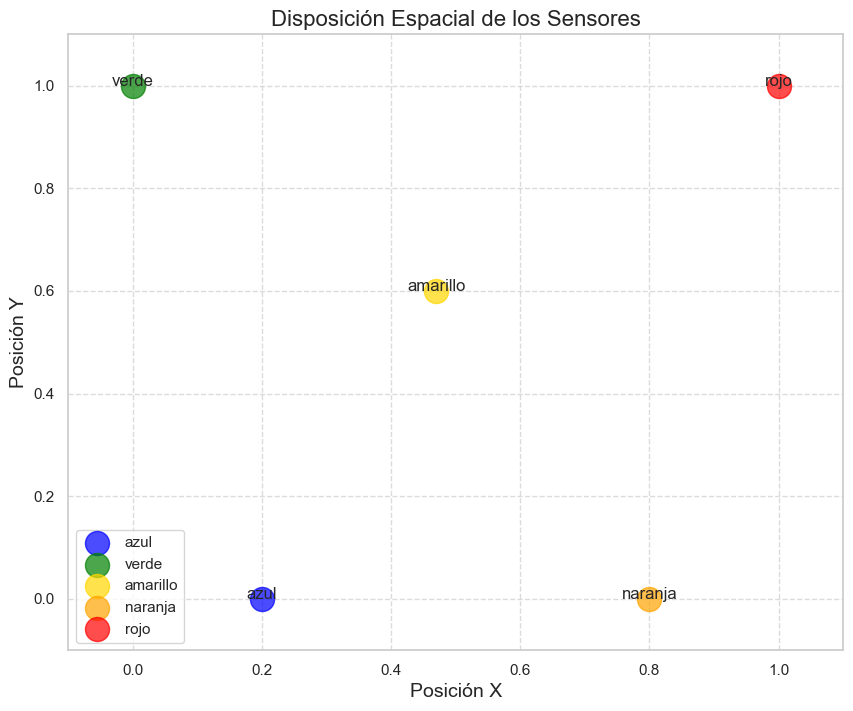

In [17]:
# Definimos las posiciones de los sensores según la documentación
# Orden: azul, verde, amarillo, naranja, rojo
POSICIONES_SENSORES = {
    'azul': (0.2, 0),      # Esquina inferior izquierda
    'verde': (0, 1),       # Esquina superior izquierda
    'amarillo': (0.47, 0.6), # Centro
    'naranja': (0.8, 0),   # Esquina inferior derecha
    'rojo': (1, 1)         # Esquina superior derecha
}

ORDEN_SENSORES = ['azul', 'verde', 'amarillo', 'naranja', 'rojo']

# Definimos colores para cada sensor para mantener consistencia en las visualizaciones
COLORES_SENSORES = {
    'azul': 'blue',
    'verde': 'green',
    'amarillo': 'gold',
    'naranja': 'orange',
    'rojo': 'red'
}

# Visualizamos la disposición espacial de los sensores
plt.figure(figsize=(10, 8))
for sensor, pos in POSICIONES_SENSORES.items():
    plt.scatter(pos[0], pos[1], s=300, color=COLORES_SENSORES[sensor], label=sensor, alpha=0.7)
    plt.text(pos[0], pos[1], sensor, fontsize=12, ha='center')

plt.xlim(-0.1, 1.1)
plt.ylim(-0.1, 1.1)
plt.grid(True, linestyle='--', alpha=0.7)
plt.title('Disposición Espacial de los Sensores', fontsize=16)
plt.xlabel('Posición X', fontsize=14)
plt.ylabel('Posición Y', fontsize=14)
plt.legend()
plt.show()

In [18]:
# Listamos todos los archivos CSV disponibles
archivos_csv = glob.glob('*.csv')
print(f"Archivos CSV disponibles: {archivos_csv}")

# Función para cargar y mostrar información básica de un archivo CSV
def cargar_y_explorar_csv(archivo):
    print(f"\n{'='*50}\nAnalizando: {archivo}\n{'='*50}")
    df = pd.read_csv(archivo)
    
    # Renombramos las columnas si es necesario para asegurar consistencia
    if 'tiempo' not in df.columns and len(df.columns) == 6:
        df.columns = ['tiempo', 'azul', 'verde', 'amarillo', 'naranja', 'rojo']
    
    print(f"Dimensiones: {df.shape}")
    print("\nPrimeras 5 filas:")
    display(df.head())
    
    print("\nEstadísticas descriptivas:")
    display(df.describe())
    
    # Calculamos la duración del experimento
    duracion = df['tiempo'].max() - df['tiempo'].min()
    print(f"\nDuración del experimento: {duracion:.2f} segundos")
    
    # Verificamos valores faltantes
    faltantes = df.isnull().sum()
    if faltantes.sum() > 0:
        print("\nValores faltantes:")
        display(faltantes)
    else:
        print("\nNo hay valores faltantes.")
    
    return df

# Cargamos un archivo como ejemplo
if 'paneoh.csv' in archivos_csv:
    archivo_demo = 'paneoh.csv'  # Movimiento horizontal como ejemplo
elif len(archivos_csv) > 0:
    archivo_demo = archivos_csv[1]
else:
    raise FileNotFoundError("No se encontraron archivos CSV para analizar")

df_ejemplo = cargar_y_explorar_csv(archivo_demo)

Archivos CSV disponibles: ['paneoh.csv', 'paneod1.csv', 'aaaaaaaaaaaa.csv', 'locura.csv', 'locura2.csv', 'paneov.csv', 'test1.csv']

Analizando: paneoh.csv
Dimensiones: (516, 6)

Primeras 5 filas:


,tiempo,azul,verde,amarillo,naranja,rojo
0,0.0,0,0,0,0,0
1,1.0,0,0,0,0,0
2,1.0,0,0,0,0,0
3,1.0,0,0,0,0,0
4,1.0,0,0,0,0,0



Estadísticas descriptivas:


,tiempo,azul,verde,amarillo,naranja,rojo
count,516.000000,516.000000,516.000000,516.000000,516.000000,516.000000
mean,46.581395,45.122093,42.523256,51.323643,41.509690,14.994186
std,27.491343,99.576885,127.770947,105.653445,103.570106,50.769439
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,22.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,47.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,70.000000,14.000000,0.000000,20.000000,0.000000,0.000000
max,94.000000,510.000000,661.000000,574.000000,582.000000,422.000000



Duración del experimento: 94.00 segundos

No hay valores faltantes.


## 3. Análisis Exploratorio y Visualización

Vamos a realizar una exploración visual de los datos para entender mejor el comportamiento de los sensores:

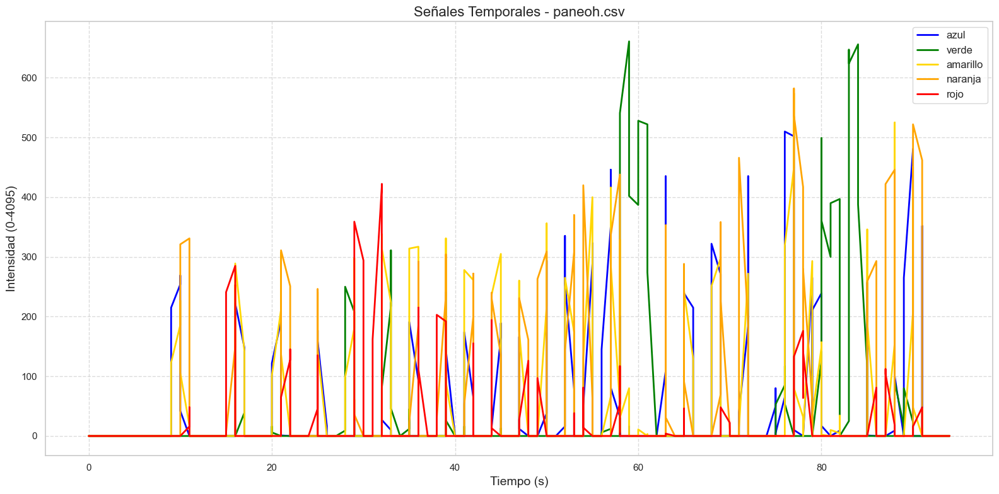

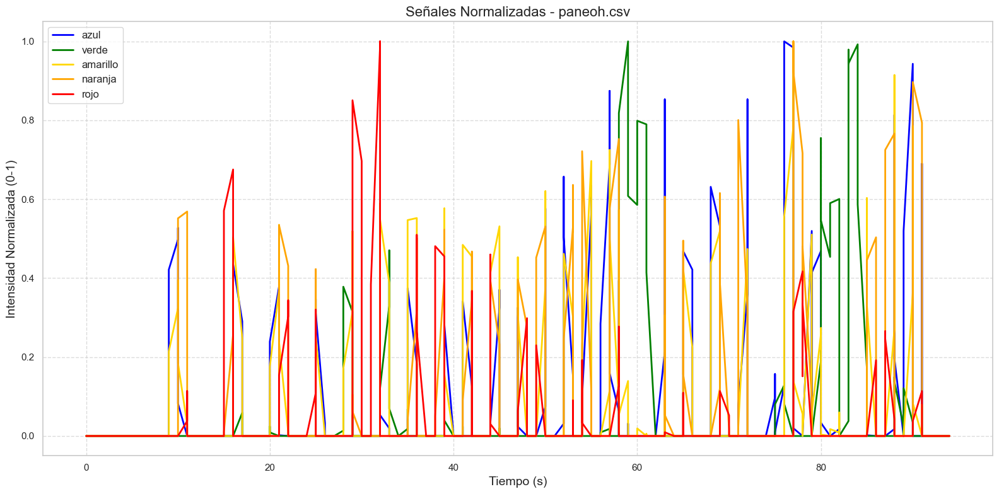

In [19]:
# Visualización de series temporales
def visualizar_series_temporales(df, titulo):
    plt.figure(figsize=(16, 8))
    
    for sensor in ORDEN_SENSORES:
        plt.plot(df['tiempo'], df[sensor], label=sensor, color=COLORES_SENSORES[sensor], linewidth=2)
    
    plt.title(f'Señales Temporales - {titulo}', fontsize=16)
    plt.xlabel('Tiempo (s)', fontsize=14)
    plt.ylabel('Intensidad (0-4095)', fontsize=14)
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.legend(fontsize=12)
    plt.tight_layout()
    plt.show()
    
    # Visualización normalizada para comparar patrones
    plt.figure(figsize=(16, 8))
    for sensor in ORDEN_SENSORES:
        # Normalizamos los valores entre 0 y 1
        valores_norm = (df[sensor] - df[sensor].min()) / (df[sensor].max() - df[sensor].min())
        plt.plot(df['tiempo'], valores_norm, label=sensor, color=COLORES_SENSORES[sensor], linewidth=2)
    
    plt.title(f'Señales Normalizadas - {titulo}', fontsize=16)
    plt.xlabel('Tiempo (s)', fontsize=14)
    plt.ylabel('Intensidad Normalizada (0-1)', fontsize=14)
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.legend(fontsize=12)
    plt.tight_layout()
    plt.show()

# Visualizamos las series temporales del dataset de ejemplo
visualizar_series_temporales(df_ejemplo, os.path.basename(archivo_demo))

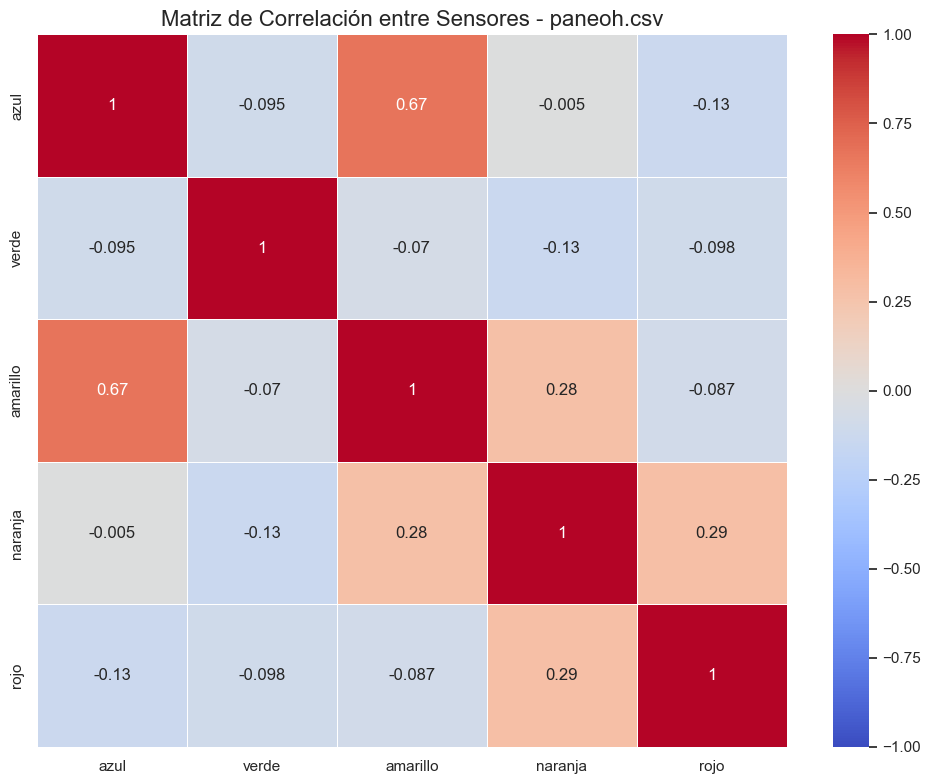

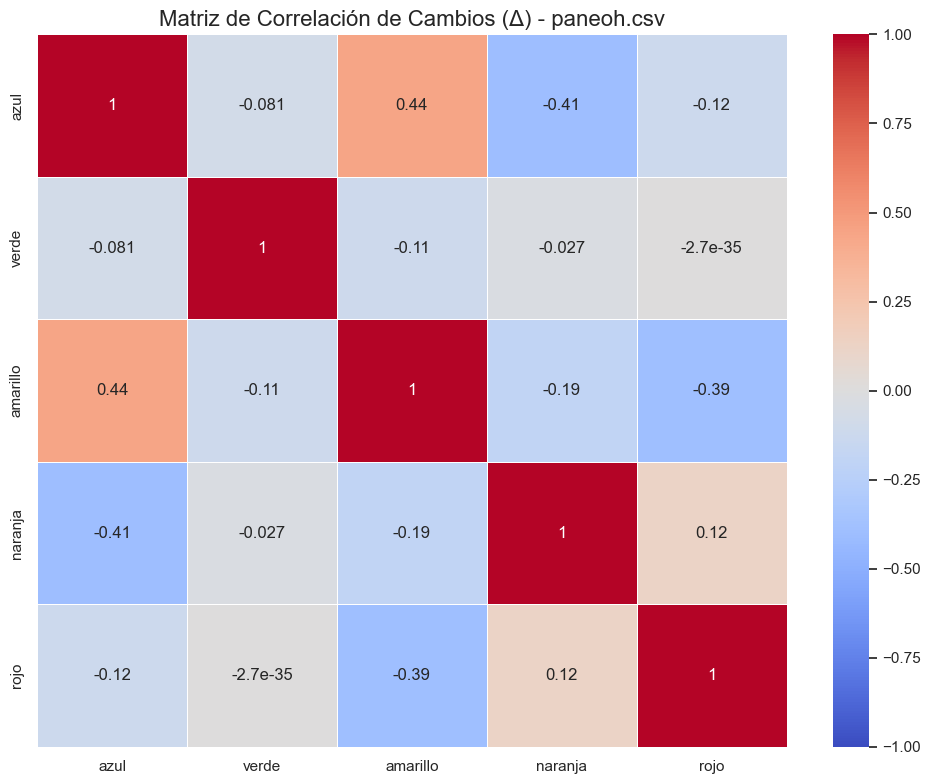

In [20]:
# Análisis de correlación entre sensores
plt.figure(figsize=(10, 8))
matriz_corr = df_ejemplo[ORDEN_SENSORES].corr()
sns.heatmap(matriz_corr, annot=True, cmap='coolwarm', linewidths=0.5, vmin=-1, vmax=1)
plt.title(f'Matriz de Correlación entre Sensores - {os.path.basename(archivo_demo)}', fontsize=16)
plt.tight_layout()
plt.show()

# Correlación con las diferencias (cambios entre lecturas consecutivas)
df_diffs = df_ejemplo[ORDEN_SENSORES].diff().dropna()
plt.figure(figsize=(10, 8))
matriz_corr_delta = df_diffs.corr()
sns.heatmap(matriz_corr_delta, annot=True, cmap='coolwarm', linewidths=0.5, vmin=-1, vmax=1)
plt.title(f'Matriz de Correlación de Cambios (Δ) - {os.path.basename(archivo_demo)}', fontsize=16)
plt.tight_layout()
plt.show()

## 4. Procesamiento de Datos y Reconstrucción de Trayectoria

Para reconstruir la posición de la fuente de luz a partir de las lecturas de los sensores, vamos a implementar un algoritmo basado en:
1. Normalización de las lecturas de los sensores
2. Cálculo de pesos para cada sensor según su intensidad (mayor intensidad = mayor peso)
3. Interpolación espacial para estimar posiciones entre sensores
4. Visualización de la trayectoria reconstruida

Vamos a crear una clase para facilitar el procesamiento:

In [21]:
class ProcesadorFototransistores:
    def __init__(self, posiciones_sensores, colores_sensores=None):
        """
        Inicializa el procesador con las posiciones de los sensores.
        
        Args:
            posiciones_sensores: Diccionario con los nombres de los sensores como claves
                                 y sus posiciones (x, y) como valores.
            colores_sensores: Diccionario opcional con los nombres de los sensores como claves
                              y sus colores para visualización como valores.
        """
        self.posiciones_sensores = posiciones_sensores
        self.sensores = list(posiciones_sensores.keys())
        
        if colores_sensores is None:
            # Colores por defecto si no se especifican
            self.colores_sensores = {
                sensor: plt.cm.tab10(i) for i, sensor in enumerate(self.sensores)
            }
        else:
            self.colores_sensores = colores_sensores
            
        # Crear malla para interpolación
        self.crear_malla(resolution=100)
        
    def crear_malla(self, resolution=100):
        """Crea una malla regular para interpolación."""
        # Determinar límites del espacio
        x_coords = [pos[0] for pos in self.posiciones_sensores.values()]
        y_coords = [pos[1] for pos in self.posiciones_sensores.values()]
        
        min_x, max_x = min(x_coords) - 0.1, max(x_coords) + 0.1
        min_y, max_y = min(y_coords) - 0.1, max(y_coords) + 0.1
        
        # Crear malla regular
        x_grid = np.linspace(min_x, max_x, resolution)
        y_grid = np.linspace(min_y, max_y, resolution)
        self.X_grid, self.Y_grid = np.meshgrid(x_grid, y_grid)
    
    def normalizar_datos(self, df):
        """
        Normaliza los datos de los sensores en un rango de 0 a 1.
        """
        df_norm = df.copy()
        
        for sensor in self.sensores:
            min_val = df[sensor].min()
            max_val = df[sensor].max()
            
            # Evitar división por cero si el sensor no varía
            if max_val > min_val:
                df_norm[sensor] = (df[sensor] - min_val) / (max_val - min_val)
            else:
                df_norm[sensor] = 0  # Si no hay variación, todos los valores son cero
        
        return df_norm
    
    def suavizar_datos(self, df, window_length=11, polyorder=3):
        """
        Aplica un filtro Savitzky-Golay para suavizar las señales.
        """
        df_smooth = df.copy()
        
        for sensor in self.sensores:
            df_smooth[sensor] = savgol_filter(df[sensor], window_length, polyorder)
        
        return df_smooth
    
    def estimar_posicion(self, valores_sensores):
        """
        Estima la posición de la fuente de luz basada en los valores de los sensores.
        Utiliza un enfoque de centro de masas ponderado.
        
        Args:
            valores_sensores: Diccionario o serie con los valores de cada sensor.
            
        Returns:
            tuple: (x, y) coordenadas estimadas de la fuente de luz.
        """
        # Obtener valores y posiciones
        pesos_total = 0
        pos_x_weighted = 0
        pos_y_weighted = 0
        
        # Para inversión (los sensores detectan más cuando están más cerca de la luz)
        # Calculamos la suma de todos los valores para normalización
        sum_values = sum(valores_sensores[sensor] for sensor in self.sensores)
        
        # Si no hay señal detectable, devolvemos el centro de la malla
        if sum_values < 0.01:
            return (0.5, 0.5)
        
        # Calculamos la posición ponderada
        for sensor in self.sensores:
            valor = valores_sensores[sensor]
            pos_x, pos_y = self.posiciones_sensores[sensor]
            
            # El peso es proporcional al valor del sensor
            peso = valor / sum_values
            
            pos_x_weighted += pos_x * peso
            pos_y_weighted += pos_y * peso
            pesos_total += peso
        
        # Normalizar por la suma de pesos
        if pesos_total > 0:
            pos_x_est = pos_x_weighted / pesos_total
            pos_y_est = pos_y_weighted / pesos_total
        else:
            # Si no hay peso detectable, devolvemos el centro
            pos_x_est, pos_y_est = 0.5, 0.5
            
        return (pos_x_est, pos_y_est)
    
    def interpolar_campo(self, valores_sensores, metodo='cubic'):
        """
        Interpola los valores de los sensores en toda la malla.
        
        Args:
            valores_sensores: Diccionario o serie con los valores de cada sensor.
            metodo: Método de interpolación ('linear', 'cubic', 'nearest')
            
        Returns:
            array: Valores interpolados en toda la malla.
        """
        # Preparar datos para interpolación
        puntos = np.array([self.posiciones_sensores[sensor] for sensor in self.sensores])
        valores = np.array([valores_sensores[sensor] for sensor in self.sensores])
        
        # Interpolar usando griddata
        valores_interpolados = griddata(
            puntos, valores, (self.X_grid, self.Y_grid), method=metodo, fill_value=0
        )
        
        return valores_interpolados
    
    def visualizar_campo_interpolado(self, valores_interpolados, pos_estimada=None, title="Campo de Intensidad Interpolado"):
        """
        Visualiza el campo de intensidad interpolado.
        
        Args:
            valores_interpolados: Array 2D con valores interpolados.
            pos_estimada: Tupla opcional (x, y) con la posición estimada de la fuente de luz.
            title: Título del gráfico.
        """
        plt.figure(figsize=(10, 8))
        
        # Visualizar campo interpolado
        plt.pcolormesh(self.X_grid, self.Y_grid, valores_interpolados, cmap='inferno', alpha=0.7, shading='auto')
        plt.colorbar(label='Intensidad')
        
        # Mostrar posiciones de los sensores
        for sensor, pos in self.posiciones_sensores.items():
            plt.scatter(pos[0], pos[1], color=self.colores_sensores[sensor], s=100, 
                       edgecolor='white', linewidth=1, label=sensor)
            
        # Mostrar posición estimada si se proporciona
        if pos_estimada is not None:
            plt.scatter(pos_estimada[0], pos_estimada[1], marker='*', color='white', 
                       s=200, edgecolor='black', linewidth=1, label='Posición Estimada')
            
        plt.title(title, fontsize=16)
        plt.xlabel('Posición X', fontsize=14)
        plt.ylabel('Posición Y', fontsize=14)
        plt.xlim(-0.1, 1.1)
        plt.ylim(-0.1, 1.1)
        plt.grid(True, linestyle='--', alpha=0.3)
        plt.legend(loc='upper right')
        plt.tight_layout()
        
    def procesar_dataframe(self, df, suavizar=True):
        """
        Procesa todo el DataFrame para obtener la trayectoria estimada.
        
        Args:
            df: DataFrame con los datos de los sensores.
            suavizar: Si es True, aplica suavizado a las señales.
            
        Returns:
            DataFrame: Datos procesados con las posiciones estimadas.
        """
        # Primero normalizamos los datos
        df_norm = self.normalizar_datos(df)
        
        # Aplicamos suavizado si se solicita
        if suavizar:
            df_norm = self.suavizar_datos(df_norm)
        
        # Creamos un nuevo DataFrame para los resultados
        df_resultado = pd.DataFrame({
            'tiempo': df['tiempo']
        })
        
        # Añadimos los valores normalizados (y posiblemente suavizados) de los sensores
        for sensor in self.sensores:
            df_resultado[f'{sensor}_norm'] = df_norm[sensor]
        
        # Calculamos la posición estimada para cada punto de tiempo
        posiciones_estimadas = []
        confianza_estimaciones = []
        
        for i, row in df_norm.iterrows():
            valores = {sensor: row[sensor] for sensor in self.sensores}
            pos_est = self.estimar_posicion(valores)
            posiciones_estimadas.append(pos_est)
            
            # Calculamos un valor de confianza basado en la suma de señales
            # Más señal total = más confianza en la estimación
            confianza = sum(valores.values()) / len(valores)
            confianza_estimaciones.append(confianza)
        
        df_resultado['pos_x'] = [pos[0] for pos in posiciones_estimadas]
        df_resultado['pos_y'] = [pos[1] for pos in posiciones_estimadas]
        df_resultado['confianza'] = confianza_estimaciones
        
        return df_resultado
    
    def visualizar_trayectoria(self, df_resultado, title="Trayectoria Estimada", colorear_por_tiempo=True):
        """
        Visualiza la trayectoria estimada.
        
        Args:
            df_resultado: DataFrame con los resultados del procesamiento.
            title: Título del gráfico.
            colorear_por_tiempo: Si es True, colorea la trayectoria según el tiempo.
        """
        plt.figure(figsize=(12, 10))
        
        # Mostrar posiciones de los sensores
        for sensor, pos in self.posiciones_sensores.items():
            plt.scatter(pos[0], pos[1], color=self.colores_sensores[sensor], s=150, 
                       edgecolor='white', linewidth=1, label=sensor, alpha=0.7, zorder=10)
            plt.text(pos[0], pos[1], sensor, fontsize=12, ha='center', va='bottom')
        
        # Colorear trayectoria por tiempo o confianza
        if colorear_por_tiempo:
            tiempo_norm = (df_resultado['tiempo'] - df_resultado['tiempo'].min()) / (df_resultado['tiempo'].max() - df_resultado['tiempo'].min())
            plt.scatter(df_resultado['pos_x'], df_resultado['pos_y'], 
                       c=tiempo_norm, cmap='viridis', s=df_resultado['confianza']*100, 
                       alpha=0.6, edgecolor='none', zorder=5)
            plt.colorbar(label='Tiempo Normalizado')
        else:
            plt.scatter(df_resultado['pos_x'], df_resultado['pos_y'], 
                       c=df_resultado['confianza'], cmap='plasma', s=50, 
                       alpha=0.6, edgecolor='none', zorder=5)
            plt.colorbar(label='Confianza')
        
        # Conectar puntos con líneas para mostrar trayectoria
        plt.plot(df_resultado['pos_x'], df_resultado['pos_y'], 'w-', alpha=0.3, linewidth=1, zorder=1)
        
        # Marcar inicio y fin de la trayectoria
        plt.scatter(df_resultado['pos_x'].iloc[0], df_resultado['pos_y'].iloc[0], 
                   color='lime', s=200, marker='o', edgecolor='black', linewidth=1.5, label='Inicio', zorder=15)
        plt.scatter(df_resultado['pos_x'].iloc[-1], df_resultado['pos_y'].iloc[-1], 
                   color='red', s=200, marker='X', edgecolor='black', linewidth=1.5, label='Fin', zorder=15)
        
        plt.title(title, fontsize=16)
        plt.xlabel('Posición X', fontsize=14)
        plt.ylabel('Posición Y', fontsize=14)
        plt.xlim(-0.1, 1.1)
        plt.ylim(-0.1, 1.1)
        plt.grid(True, linestyle='--', alpha=0.3)
        plt.legend(loc='upper right')
        plt.tight_layout()
    
    def crear_animacion(self, df_resultado, interval=50, save_file=None):
        """
        Crea una animación de la trayectoria y el campo de intensidad.
        
        Args:
            df_resultado: DataFrame con los resultados del procesamiento.
            interval: Intervalo entre frames en ms.
            save_file: Si se proporciona, guarda la animación en este archivo.
        """
        fig, ax = plt.subplots(figsize=(12, 10))
        
        # Función para actualizar cada frame
        def update(frame):
            ax.clear()
            
            # Obtener datos para este frame
            row = df_resultado.iloc[frame]
            tiempo = row['tiempo']
            pos_x, pos_y = row['pos_x'], row['pos_y']
            
            # Preparar valores para interpolar
            valores_sensores = {sensor: row[f'{sensor}_norm'] for sensor in self.sensores}
            valores_interpolados = self.interpolar_campo(valores_sensores)
            
            # Visualizar campo interpolado
            mesh = ax.pcolormesh(self.X_grid, self.Y_grid, valores_interpolados, 
                                cmap='inferno', alpha=0.7, shading='auto')
            
            # Mostrar posiciones de los sensores
            for sensor, pos in self.posiciones_sensores.items():
                ax.scatter(pos[0], pos[1], color=self.colores_sensores[sensor], s=100, 
                          edgecolor='white', linewidth=1)
                ax.text(pos[0], pos[1], sensor, fontsize=10, ha='center')
            
            # Mostrar posición estimada
            ax.scatter(pos_x, pos_y, marker='*', color='white', s=200, 
                      edgecolor='black', linewidth=1, label='Posición Estimada')
            
            # Mostrar trayectoria hasta este punto
            subset = df_resultado.iloc[:frame+1]
            ax.plot(subset['pos_x'], subset['pos_y'], 'w-', alpha=0.5, linewidth=1)
            
            # Ajustar límites y etiquetas
            ax.set_xlim(-0.1, 1.1)
            ax.set_ylim(-0.1, 1.1)
            ax.grid(True, linestyle='--', alpha=0.3)
            ax.set_title(f'Tiempo: {tiempo:.2f}s', fontsize=16)
            ax.set_xlabel('Posición X', fontsize=14)
            ax.set_ylabel('Posición Y', fontsize=14)
            
            return [mesh]
        
        # Crear animación
        anim = animation.FuncAnimation(
            fig, update, frames=len(df_resultado), 
            interval=interval, blit=False
        )
        
        plt.close()  # Evitar mostrar la figura estática
        
        # Guardar animación si se solicita
        if save_file:
            anim.save(save_file, writer='pillow', fps=30)
        
        return anim

Datos procesados:


,tiempo,azul_norm,verde_norm,amarillo_norm,naranja_norm,rojo_norm,pos_x,pos_y,confianza
0,0.0,0.0,0.0,0.0,0.0,0.0,0.5,0.5,0.0
1,1.0,0.0,0.0,0.0,0.0,0.0,0.5,0.5,0.0
2,1.0,0.0,0.0,0.0,0.0,0.0,0.5,0.5,0.0
3,1.0,0.0,0.0,0.0,0.0,0.0,0.5,0.5,0.0
4,1.0,0.0,0.0,0.0,0.0,0.0,0.5,0.5,0.0


/home/juan/Workspace/Base/Python/LabAv1/venv/lib/python3.11/site-packages/matplotlib/collections.py:999: RuntimeWarning:

invalid value encountered in sqrt



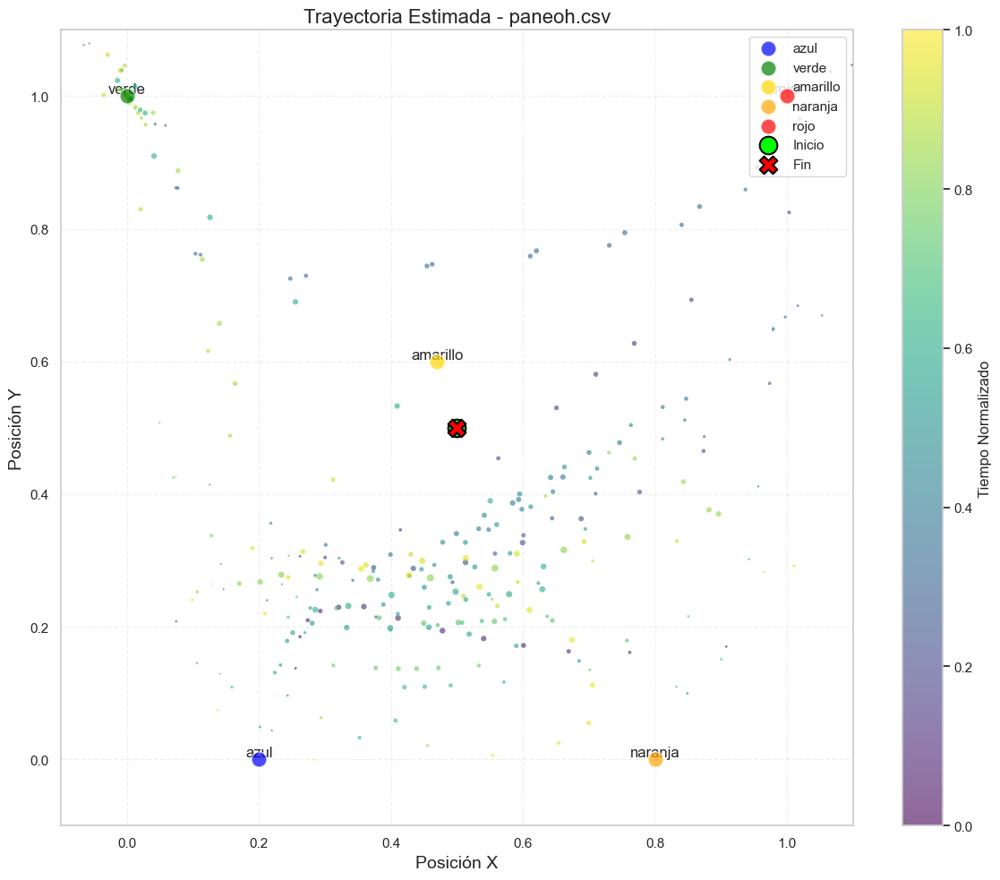

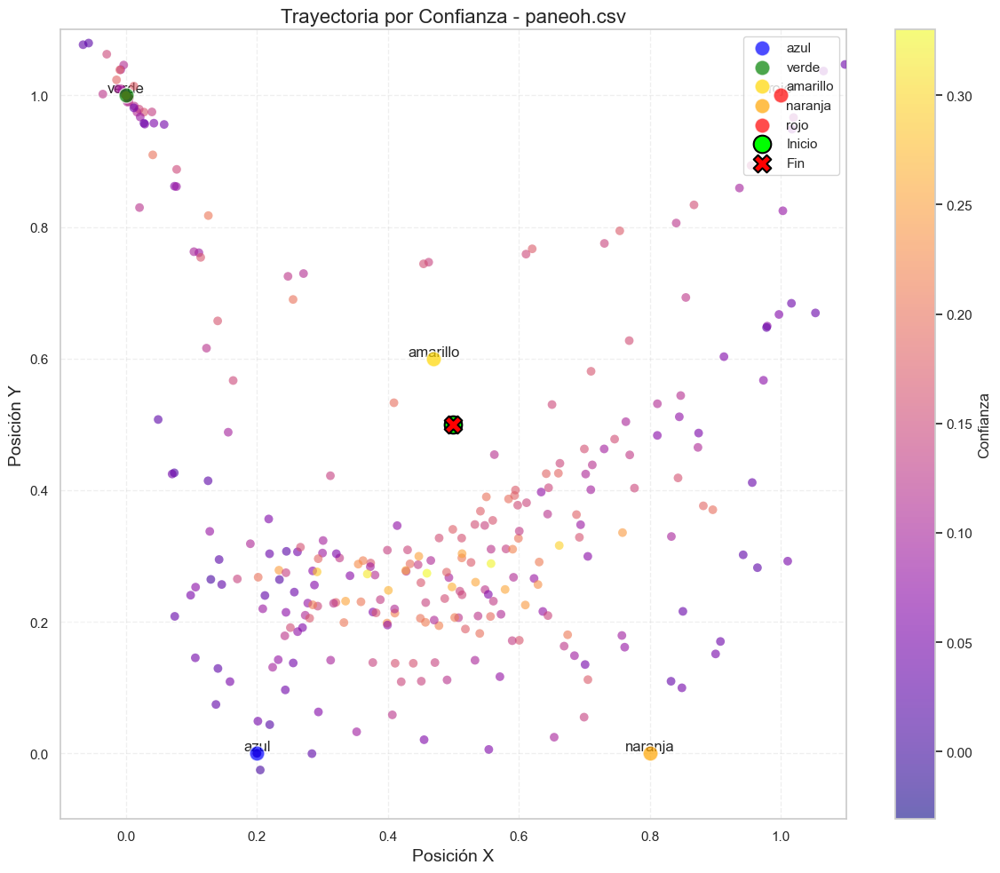

In [22]:
# Instanciamos el procesador con las posiciones y colores de los sensores
procesador = ProcesadorFototransistores(POSICIONES_SENSORES, COLORES_SENSORES)

# Procesamos los datos del archivo de ejemplo
df_procesado = procesador.procesar_dataframe(df_ejemplo, suavizar=True)

# Mostramos las primeras filas del resultado
print("Datos procesados:")
display(df_procesado.head())

# Visualizamos la trayectoria estimada
procesador.visualizar_trayectoria(df_procesado, title=f"Trayectoria Estimada - {os.path.basename(archivo_demo)}")

# Visualizamos también coloreando por confianza
procesador.visualizar_trayectoria(df_procesado, title=f"Trayectoria por Confianza - {os.path.basename(archivo_demo)}", 
                                colorear_por_tiempo=False)

## 5. Visualización Espaciotemporal

Vamos a visualizar cómo evoluciona el campo de intensidad en diferentes momentos:

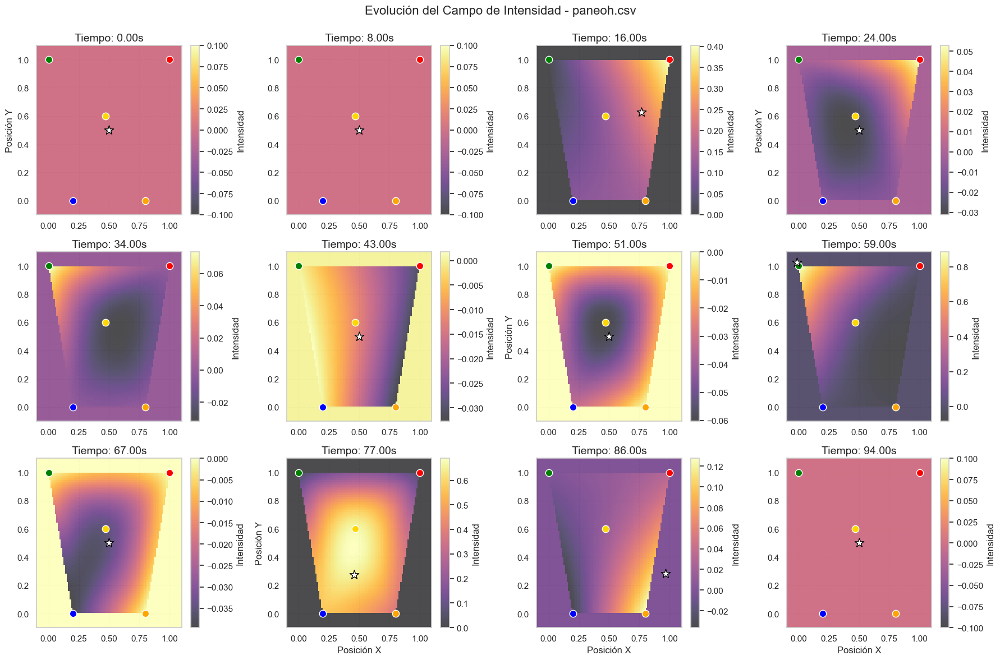

In [23]:
# Seleccionamos varios momentos específicos para visualizar
n_frames = 12  # Número de frames a mostrar
indices = np.linspace(0, len(df_procesado) - 1, n_frames, dtype=int)

plt.figure(figsize=(18, 12))

for i, idx in enumerate(indices):
    # Obtener datos para este momento
    row = df_procesado.iloc[idx]
    tiempo = row['tiempo']
    pos_x, pos_y = row['pos_x'], row['pos_y']
    
    # Preparar valores para interpolar
    valores_sensores = {sensor: row[f'{sensor}_norm'] for sensor in ORDEN_SENSORES}
    valores_interpolados = procesador.interpolar_campo(valores_sensores, metodo='cubic')
    
    # Crear subplot
    plt.subplot(3, 4, i + 1)
    
    # Visualizar campo interpolado
    plt.pcolormesh(procesador.X_grid, procesador.Y_grid, valores_interpolados, 
                  cmap='inferno', alpha=0.7, shading='auto')
    plt.colorbar(label='Intensidad')
    
    # Mostrar posiciones de los sensores
    for sensor, pos in POSICIONES_SENSORES.items():
        plt.scatter(pos[0], pos[1], color=COLORES_SENSORES[sensor], s=80, 
                   edgecolor='white', linewidth=1)
    
    # Mostrar posición estimada
    plt.scatter(pos_x, pos_y, marker='*', color='white', s=150, 
               edgecolor='black', linewidth=1, label='Posición Estimada')
    
    # Ajustar límites y etiquetas
    plt.xlim(-0.1, 1.1)
    plt.ylim(-0.1, 1.1)
    plt.grid(True, linestyle='--', alpha=0.3)
    plt.title(f'Tiempo: {tiempo:.2f}s', fontsize=14)
    
    if i >= n_frames - 3:  # Solo añadir etiquetas en la fila inferior
        plt.xlabel('Posición X', fontsize=12)
    
    if i % 3 == 0:  # Solo añadir etiquetas en la primera columna
        plt.ylabel('Posición Y', fontsize=12)

plt.suptitle(f'Evolución del Campo de Intensidad - {os.path.basename(archivo_demo)}', fontsize=16)
plt.tight_layout()
plt.subplots_adjust(top=0.92)
plt.show()

In [24]:
# Creamos una animación de la evolución espaciotemporal
# Para acelerar la visualización, tomaremos un subconjunto de los datos
step = max(1, len(df_procesado) // 100)  # Tomar máximo 100 frames para la animación
df_anim = df_procesado.iloc[::step].reset_index(drop=True)

print(f"Creando animación con {len(df_anim)} frames...")
ani = procesador.crear_animacion(df_anim, interval=100)

# Mostrar la animación
from IPython.display import HTML
HTML(ani.to_jshtml())

Creando animación con 104 frames...


## 6. Comparación de Patrones de Movimiento

Vamos a comparar los diferentes patrones de movimiento (horizontal, vertical, diagonal/circular) para visualizar cómo se reconstruyen diferentes trayectorias:


Procesando patrón: horizontal (paneoh.csv)

Analizando: paneoh.csv
Dimensiones: (516, 6)

Primeras 5 filas:


,tiempo,azul,verde,amarillo,naranja,rojo
0,0.0,0,0,0,0,0
1,1.0,0,0,0,0,0
2,1.0,0,0,0,0,0
3,1.0,0,0,0,0,0
4,1.0,0,0,0,0,0



Estadísticas descriptivas:


,tiempo,azul,verde,amarillo,naranja,rojo
count,516.000000,516.000000,516.000000,516.000000,516.000000,516.000000
mean,46.581395,45.122093,42.523256,51.323643,41.509690,14.994186
std,27.491343,99.576885,127.770947,105.653445,103.570106,50.769439
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,22.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,47.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,70.000000,14.000000,0.000000,20.000000,0.000000,0.000000
max,94.000000,510.000000,661.000000,574.000000,582.000000,422.000000



Duración del experimento: 94.00 segundos

No hay valores faltantes.

Procesando patrón: vertical (paneov.csv)

Analizando: paneov.csv
Dimensiones: (481, 6)

Primeras 5 filas:


,tiempo,azul,verde,amarillo,naranja,rojo
0,0.0,0,0,0,0,0
1,0.0,0,0,0,0,0
2,0.0,0,0,0,0,0
3,0.0,0,0,0,0,0
4,1.0,0,0,0,0,0



Estadísticas descriptivas:


,tiempo,azul,verde,amarillo,naranja,rojo
count,481.000000,481.000000,481.000000,481.000000,481.000000,481.000000
mean,43.247401,93.288981,16.731809,79.193347,31.209979,4.374220
std,25.836891,175.333176,51.199618,167.478301,92.730993,19.179016
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,20.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,44.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,65.000000,96.000000,0.000000,47.000000,0.000000,0.000000
max,88.000000,759.000000,420.000000,765.000000,752.000000,236.000000



Duración del experimento: 88.00 segundos

No hay valores faltantes.

Procesando patrón: diagonal (paneod1.csv)

Analizando: paneod1.csv
Dimensiones: (435, 6)

Primeras 5 filas:


,tiempo,azul,verde,amarillo,naranja,rojo
0,0.0,0,0,0,0,0
1,0.0,0,0,0,0,0
2,0.0,0,0,0,0,0
3,0.0,0,0,0,0,0
4,0.0,0,0,0,0,0



Estadísticas descriptivas:


,tiempo,azul,verde,amarillo,naranja,rojo
count,435.000000,435.000000,435.000000,435.000000,435.000000,435.000000
mean,39.358621,77.749425,0.285057,56.328736,26.701149,70.629885
std,23.474570,183.227577,4.247160,138.728542,78.588691,168.797601
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,18.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,40.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,59.500000,1.000000,0.000000,0.000000,0.000000,0.000000
max,81.000000,889.000000,80.000000,639.000000,495.000000,768.000000



Duración del experimento: 81.00 segundos

No hay valores faltantes.

Procesando patrón: aleatorio (locura.csv)

Analizando: locura.csv
Dimensiones: (875, 6)

Primeras 5 filas:


,tiempo,azul,verde,amarillo,naranja,rojo
0,0.0,0,0,0,0,0
1,0.0,0,0,0,0,0
2,1.0,0,0,0,0,0
3,1.0,0,0,0,0,0
4,1.0,0,0,0,0,0



Estadísticas descriptivas:


,tiempo,azul,verde,amarillo,naranja,rojo
count,875.000000,875.000000,875.000000,875.000000,875.000000,875.000000
mean,79.185143,239.849143,92.893714,273.806857,182.133714,96.316571
std,46.462406,347.404746,264.097650,340.930324,302.030340,233.470512
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,39.500000,0.000000,0.000000,4.500000,0.000000,0.000000
50%,79.000000,80.000000,0.000000,128.000000,41.000000,0.000000
75%,119.000000,252.500000,0.000000,454.500000,227.000000,48.000000
max,159.000000,1349.000000,1744.000000,1739.000000,1575.000000,1653.000000



Duración del experimento: 159.00 segundos

No hay valores faltantes.


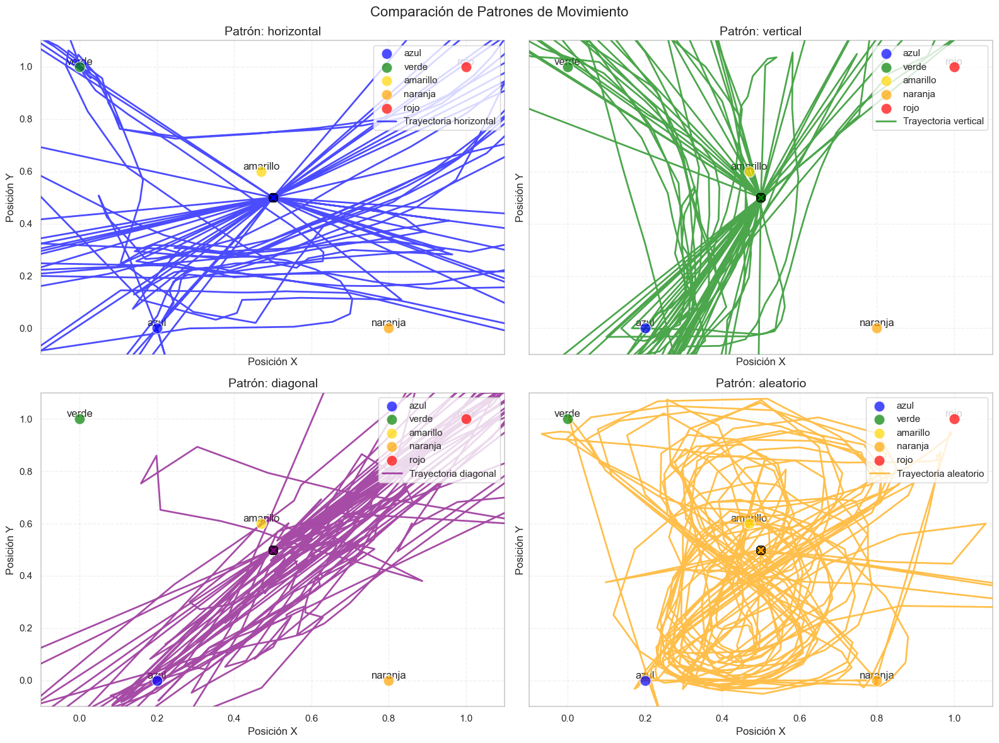

In [30]:
# Definimos patrones a analizar
patrones = {
    'horizontal': 'paneoh.csv',
    'vertical': 'paneov.csv',
    'diagonal': 'paneod1.csv',
    'aleatorio': 'locura.csv'
}

# Verificamos qué archivos existen
patrones_disponibles = {k: v for k, v in patrones.items() if v in archivos_csv}

if not patrones_disponibles:
    print("No se encontraron los archivos esperados para los diferentes patrones.")
else:
    # Procesamos cada patrón
    resultados = {}
    
    for patron, archivo in patrones_disponibles.items():
        print(f"\nProcesando patrón: {patron} ({archivo})")
        df = cargar_y_explorar_csv(archivo)
        df_resultado = procesador.procesar_dataframe(df, suavizar=True)
        resultados[patron] = df_resultado
    
    # Visualizamos las trayectorias separadas en subplots
    num_patron = len(resultados)
    cols = 2  # Número de columnas, ajustable
    rows = (num_patron + cols - 1) // cols  # Calcular filas necesarias
    
    fig, axs = plt.subplots(rows, cols, figsize=(16, 12), sharex=True, sharey=True)
    axs = axs.flatten() if num_patron > 1 else [axs]  # Aplanar para fácil indexación
    
    # Colores para cada patrón
    colores_patron = {
        'horizontal': 'blue',
        'vertical': 'green',
        'diagonal': 'purple',
        'aleatorio': 'orange'
    }
    
    # Visualizar cada trayectoria en su propio subplot
    for i, (patron, df_res) in enumerate(resultados.items()):
        ax = axs[i]
        color = colores_patron.get(patron, 'gray')
        
        # Mostrar posiciones de los sensores
        for sensor, pos in POSICIONES_SENSORES.items():
            ax.scatter(pos[0], pos[1], color=COLORES_SENSORES[sensor], s=150, 
                       edgecolor='white', linewidth=1, label=sensor, alpha=0.7, zorder=10)
            ax.text(pos[0], pos[1], sensor, fontsize=12, ha='center', va='bottom')
        
        # Visualizar la trayectoria
        ax.plot(df_res['pos_x'], df_res['pos_y'], '-', color=color, linewidth=2, 
                alpha=0.7, label=f'Trayectoria {patron}', zorder=5)
        
        # Marcar inicio y fin de la trayectoria
        ax.scatter(df_res['pos_x'].iloc[0], df_res['pos_y'].iloc[0], 
                   color=color, s=100, marker='o', edgecolor='black', linewidth=1, zorder=15)
        ax.scatter(df_res['pos_x'].iloc[-1], df_res['pos_y'].iloc[-1], 
                   color=color, s=100, marker='X', edgecolor='black', linewidth=1, zorder=15)
        
        ax.set_title(f"Patrón: {patron}", fontsize=14)
        ax.set_xlabel('Posición X', fontsize=12)
        ax.set_ylabel('Posición Y', fontsize=12)
        ax.set_xlim(-0.1, 1.1)
        ax.set_ylim(-0.1, 1.1)
        ax.grid(True, linestyle='--', alpha=0.3)
        ax.legend(loc='upper right')
    
    # Ocultar subplots vacíos si hay menos de rows*cols
    for j in range(i+1, len(axs)):
        axs[j].axis('off')
    
    fig.suptitle("Comparación de Patrones de Movimiento", fontsize=16)
    plt.tight_layout()
    plt.show()

## 7. Análisis de Sensibilidad y Precisión

Vamos a analizar la sensibilidad del sistema y evaluar la precisión de la reconstrucción. Para esto:
1. Identificaremos los picos en las señales de cada sensor
2. Analizaremos la correlación entre los picos y las posiciones estimadas
3. Evaluaremos la confianza de las estimaciones en diferentes regiones del espacio

Realizando análisis de sensibilidad para el patrón: horizontal


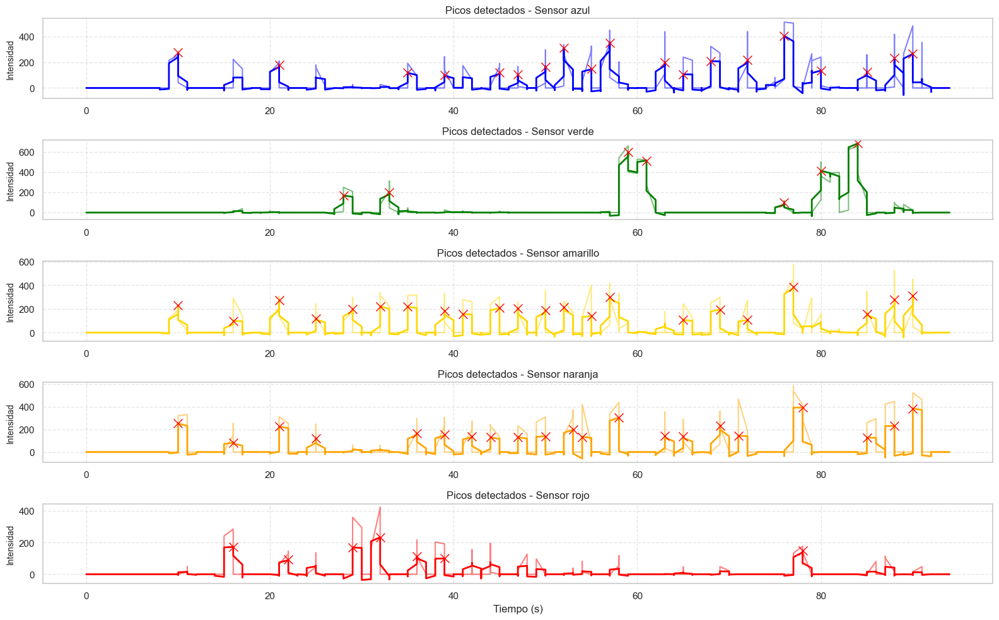

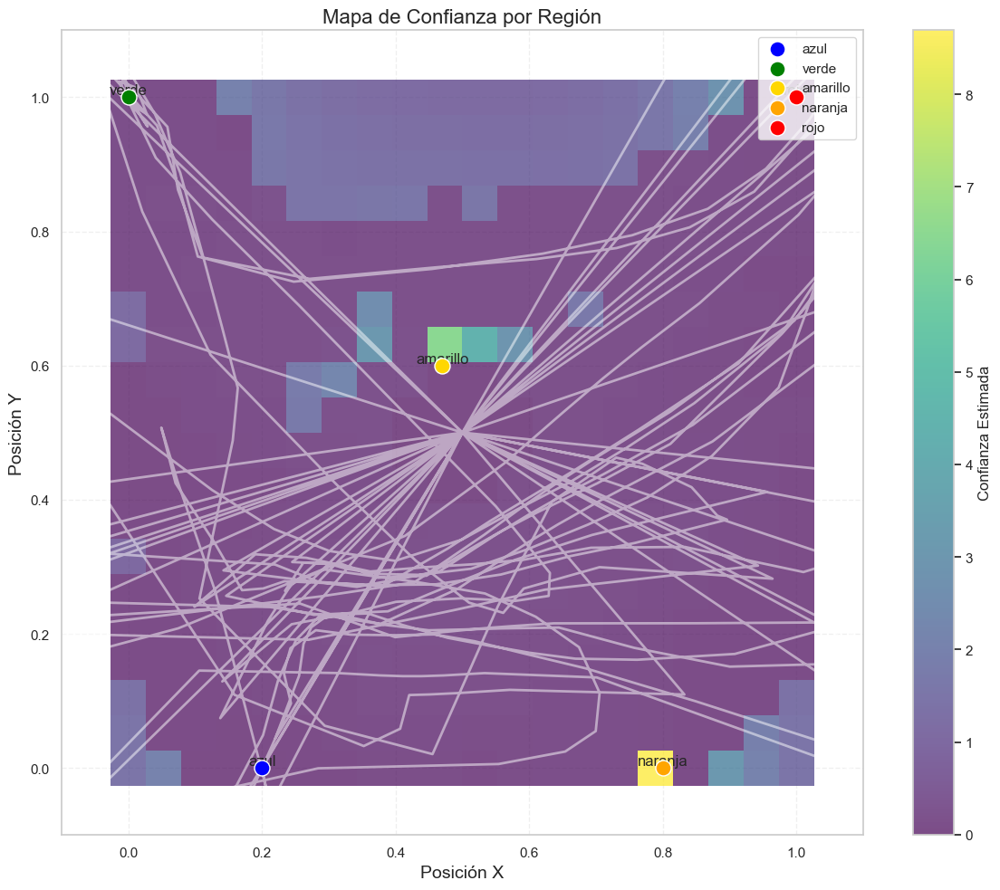


Estadísticas de eventos detectados:


,tiempo,valor,prominencia,pos_x,pos_y,distancia_sensor
count,76.000000,76.000000,76.000000,76.000000,76.000000,76.000000
mean,52.302632,209.460434,225.259753,0.546250,0.416470,0.510363
std,22.988704,114.227264,110.019343,0.593653,0.235297,0.484248
min,10.000000,82.822844,104.053613,-0.056995,0.032642,0.000000
25%,35.000000,133.667249,150.709207,0.250167,0.251159,0.314790
50%,52.000000,179.216783,195.899767,0.449642,0.369125,0.420514
75%,71.250000,232.852564,264.774476,0.606040,0.500000,0.570820
max,90.000000,684.275058,709.519814,3.158980,1.079660,2.967958


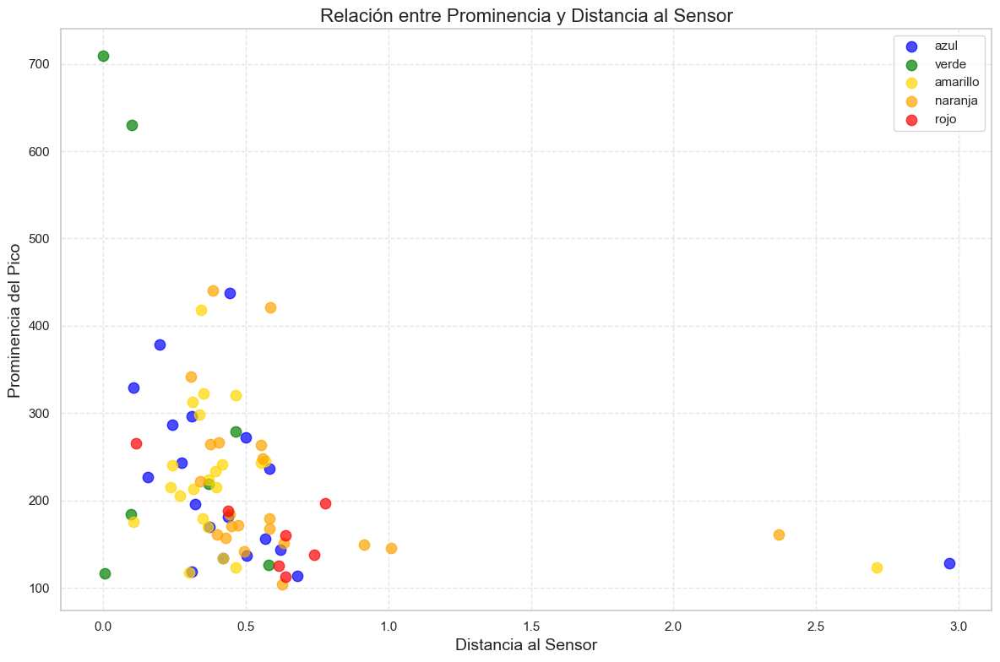


Estadísticas por regiones:


,región,n_puntos,confianza_media,confianza_std
0,Inferior Izquierdo,299,0.041851,0.076004
1,Inferior Derecho,280,0.042633,0.077122
2,Superior Izquierdo,233,0.020609,0.056292
3,Superior Derecho,210,0.007559,0.039067
4,Centro,273,0.046240,0.084044


In [26]:
# Tomamos uno de los patrones para análisis detallado
if 'horizontal' in resultados:
    patron = 'horizontal'
    df_original = pd.read_csv(patrones[patron])
    df_resultado = resultados[patron]
elif len(resultados) > 0:
    patron = list(resultados.keys())[0]
    df_original = pd.read_csv(patrones[patron])
    df_resultado = resultados[patron]
else:
    # Si no hay resultados de patrones, usamos el dataset de ejemplo
    patron = os.path.basename(archivo_demo)
    df_original = df_ejemplo
    df_resultado = df_procesado

print(f"Realizando análisis de sensibilidad para el patrón: {patron}")

# Detectamos picos en las señales de cada sensor
resultados_picos = {}
plt.figure(figsize=(16, 10))

for i, sensor in enumerate(ORDEN_SENSORES):
    # Aplicamos un suavizado para mejorar la detección de picos
    señal_suavizada = savgol_filter(df_original[sensor], 11, 3)
    
    # Detectamos picos (máximos locales)
    picos, propiedades = find_peaks(señal_suavizada, height=0, distance=10, prominence=100)
    
    # Guardamos los resultados
    resultados_picos[sensor] = {
        'indices': picos,
        'tiempos': df_original['tiempo'].iloc[picos],
        'valores': señal_suavizada[picos],
        'prominencia': propiedades['prominences']
    }
    
    # Visualizamos
    plt.subplot(len(ORDEN_SENSORES), 1, i+1)
    plt.plot(df_original['tiempo'], df_original[sensor], alpha=0.5, color=COLORES_SENSORES[sensor])
    plt.plot(df_original['tiempo'], señal_suavizada, color=COLORES_SENSORES[sensor], linewidth=2)
    plt.plot(df_original['tiempo'].iloc[picos], señal_suavizada[picos], 'x', 
             color='red', markersize=10)
    plt.title(f'Picos detectados - Sensor {sensor}', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.5)
    
    if i == len(ORDEN_SENSORES) - 1:
        plt.xlabel('Tiempo (s)', fontsize=12)
    
    plt.ylabel('Intensidad', fontsize=10)

plt.tight_layout()
plt.show()

# Análisis de confianza en diferentes regiones
# Creamos una malla para visualizar la confianza por región
x_grid = np.linspace(0, 1, 20)
y_grid = np.linspace(0, 1, 20)
X_vis, Y_vis = np.meshgrid(x_grid, y_grid)
confianza = np.zeros_like(X_vis)

# Para cada punto de la malla, calculamos la confianza promedio
for i, x in enumerate(x_grid):
    for j, y in enumerate(y_grid):
        # Encontramos puntos cercanos en la trayectoria
        distancias = np.sqrt((df_resultado['pos_x'] - x)**2 + (df_resultado['pos_y'] - y)**2)
        cercanos = distancias < 0.1  # Umbral de distancia
        
        if np.any(cercanos):
            confianza[j, i] = df_resultado.loc[cercanos, 'confianza'].mean()
        else:
            # Si no hay puntos cercanos, estimamos por interpolación
            # Calculamos la distancia a cada sensor
            dist_sensores = {
                sensor: np.sqrt((pos[0] - x)**2 + (pos[1] - y)**2)
                for sensor, pos in POSICIONES_SENSORES.items()
            }
            # Inversamente proporcional a la distancia
            pesos = {s: 1/(d+0.1)**2 for s, d in dist_sensores.items()}
            confianza[j, i] = 0.5 * sum(pesos.values()) / len(pesos)

# Visualizamos el mapa de confianza
plt.figure(figsize=(12, 10))
contour = plt.pcolormesh(X_vis, Y_vis, confianza, cmap='viridis', alpha=0.7, shading='auto')
plt.colorbar(contour, label='Confianza Estimada')

# Mostramos posiciones de los sensores
for sensor, pos in POSICIONES_SENSORES.items():
    plt.scatter(pos[0], pos[1], color=COLORES_SENSORES[sensor], s=150, 
               edgecolor='white', linewidth=1, label=sensor, zorder=10)
    plt.text(pos[0], pos[1], sensor, fontsize=12, ha='center', va='bottom')

# Mostramos la trayectoria
plt.plot(df_resultado['pos_x'], df_resultado['pos_y'], 'w-', alpha=0.5, linewidth=2)

plt.title("Mapa de Confianza por Región", fontsize=16)
plt.xlabel('Posición X', fontsize=14)
plt.ylabel('Posición Y', fontsize=14)
plt.xlim(-0.1, 1.1)
plt.ylim(-0.1, 1.1)
plt.grid(True, linestyle='--', alpha=0.3)
plt.legend(loc='upper right')
plt.tight_layout()
plt.show()

# Creamos un DataFrame con características y estadísticas
eventos = []

for sensor, datos in resultados_picos.items():
    for i, (tiempo, valor, prominencia) in enumerate(zip(
        datos['tiempos'], datos['valores'], datos['prominencia'])):
        
        # Encontramos el índice más cercano en el tiempo en los resultados
        idx_cercano = np.abs(df_resultado['tiempo'] - tiempo).argmin()
        
        # Obtenemos la posición estimada en ese momento
        pos_x = df_resultado.iloc[idx_cercano]['pos_x']
        pos_y = df_resultado.iloc[idx_cercano]['pos_y']
        
        # Calculamos la distancia al sensor
        pos_sensor = POSICIONES_SENSORES[sensor]
        distancia = np.sqrt((pos_x - pos_sensor[0])**2 + (pos_y - pos_sensor[1])**2)
        
        # Guardamos el evento
        eventos.append({
            'sensor': sensor,
            'tiempo': tiempo,
            'valor': valor,
            'prominencia': prominencia,
            'pos_x': pos_x,
            'pos_y': pos_y,
            'distancia_sensor': distancia
        })

# Convertimos a DataFrame
df_caracteristicas = pd.DataFrame(eventos)

# Mostramos estadísticas
print("\nEstadísticas de eventos detectados:")
display(df_caracteristicas.describe())

# Analizamos la relación entre prominencia y distancia
plt.figure(figsize=(12, 8))
for sensor in ORDEN_SENSORES:
    subset = df_caracteristicas[df_caracteristicas['sensor'] == sensor]
    plt.scatter(subset['distancia_sensor'], subset['prominencia'], 
               label=sensor, color=COLORES_SENSORES[sensor], s=80, alpha=0.7)

plt.title("Relación entre Prominencia y Distancia al Sensor", fontsize=16)
plt.xlabel('Distancia al Sensor', fontsize=14)
plt.ylabel('Prominencia del Pico', fontsize=14)
plt.grid(True, linestyle='--', alpha=0.5)
plt.legend()
plt.tight_layout()
plt.show()

# Estadísticas por regiones
# Dividimos el espacio en cuadrantes
cuadrantes = {
    'Inferior Izquierdo': (0, 0.5, 0, 0.5),
    'Inferior Derecho': (0.5, 1, 0, 0.5),
    'Superior Izquierdo': (0, 0.5, 0.5, 1),
    'Superior Derecho': (0.5, 1, 0.5, 1),
    'Centro': (0.25, 0.75, 0.25, 0.75)
}

stats = []

for region, (x_min, x_max, y_min, y_max) in cuadrantes.items():
    # Filtramos puntos en esta región
    mask = (
        (df_resultado['pos_x'] >= x_min) & 
        (df_resultado['pos_x'] <= x_max) & 
        (df_resultado['pos_y'] >= y_min) & 
        (df_resultado['pos_y'] <= y_max)
    )
    
    if mask.sum() > 0:
        stats.append({
            'región': region,
            'n_puntos': mask.sum(),
            'confianza_media': df_resultado.loc[mask, 'confianza'].mean(),
            'confianza_std': df_resultado.loc[mask, 'confianza'].std()
        })

stats_df = pd.DataFrame(stats)
print("\nEstadísticas por regiones:")
display(stats_df)

## 8. Conclusiones y Discusión

En este análisis hemos logrado:

1. **Reconstrucción de Trayectorias**: Hemos implementado un método para reconstruir la posición de una fuente de luz puntual basado en las lecturas de 5 fototransistores distribuidos espacialmente.

2. **Visualización Espaciotemporal**: Hemos creado visualizaciones estáticas y animaciones que muestran cómo evoluciona la distribución de intensidad lumínica en el espacio a lo largo del tiempo.

3. **Interpolación Espacial**: Mediante técnicas de interpolación, hemos estimado la intensidad lumínica en todo el espacio, incluso en áreas donde no hay sensores físicos.

4. **Análisis de Precisión**: Hemos evaluado la confianza de nuestras estimaciones en diferentes regiones del espacio y analizado la relación entre las características de los picos de señal y la posición de la fuente.

### Limitaciones y Mejoras Posibles

- **Densidad de Sensores**: Con solo 5 sensores, hay regiones con baja confianza en la estimación. Aumentar el número de sensores mejoraría la precisión.

- **Calibración**: Implementar un proceso de calibración para normalizar las diferencias en sensibilidad entre sensores.

- **Algoritmos Avanzados**: Se podrían implementar algoritmos más sofisticados (como filtros de partículas o redes neuronales) para mejorar la estimación de posición.

- **Modelado de la Emisión**: Incorporar un modelo físico más detallado de cómo la luz se dispersa desde una fuente puntual mejoraría la precisión de la interpolación.

### Aplicaciones Potenciales

Esta técnica de reconstrucción de posición basada en sensores de luz podría aplicarse en:

- Sistemas de seguimiento de objetos de bajo costo
- Interfaces humano-máquina basadas en movimiento
- Monitoreo de movimiento en espacios controlados
- Aplicaciones educativas para demostrar principios de óptica y procesamiento de señales

Tiempo 0: Posición estimada (0.51, 0.56)
Tiempo 1: Posición estimada (0.51, 0.56)
Tiempo 2: Posición estimada (0.51, 0.56)
Tiempo 3: Posición estimada (0.51, 0.56)
Tiempo 4: Posición estimada (0.51, 0.56)
Tiempo 5: Posición estimada (0.51, 0.56)
Tiempo 6: Posición estimada (0.51, 0.56)
Tiempo 7: Posición estimada (0.51, 0.56)
Tiempo 8: Posición estimada (0.51, 0.56)
Tiempo 9: Posición estimada (0.51, 0.56)
Tiempo 10: Posición estimada (0.51, 0.56)
Tiempo 11: Posición estimada (0.51, 0.56)
Tiempo 12: Posición estimada (0.51, 0.56)
Tiempo 13: Posición estimada (0.51, 0.56)
Tiempo 14: Posición estimada (0.51, 0.56)
Tiempo 15: Posición estimada (0.51, 0.56)
Tiempo 16: Posición estimada (0.51, 0.56)
Tiempo 17: Posición estimada (0.51, 0.56)
Tiempo 18: Posición estimada (0.51, 0.56)
Tiempo 19: Posición estimada (0.51, 0.56)
Tiempo 20: Posición estimada (0.51, 0.56)
Tiempo 21: Posición estimada (0.51, 0.56)
Tiempo 22: Posición estimada (0.51, 0.56)
Tiempo 23: Posición estimada (0.51, 0.56)
Ti

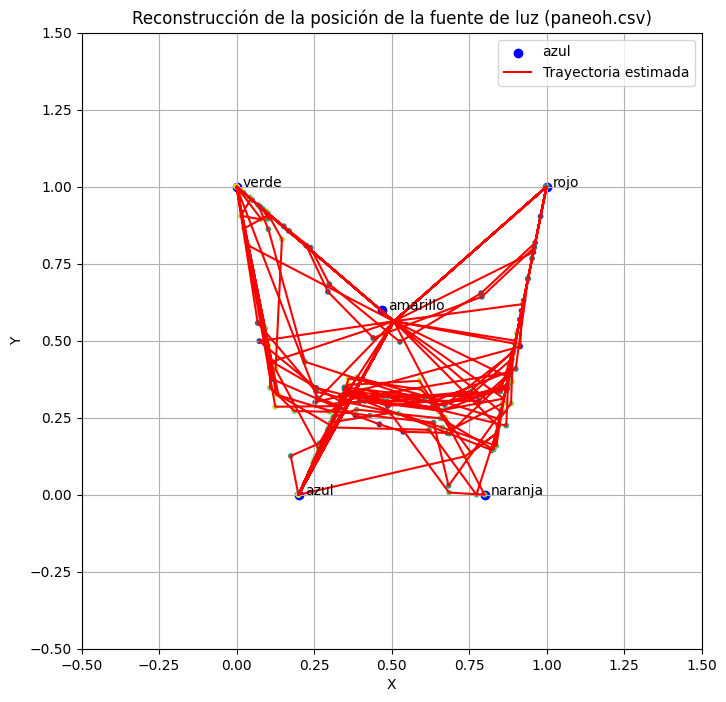

In [1]:
import pandas as pd
import numpy as np
from scipy.optimize import minimize
import matplotlib.pyplot as plt

# Definir las posiciones de los sensores
sensors = {
    'azul': (0.2, 0),
    'verde': (0, 1),
    'amarillo': (0.47, 0.6),
    'naranja': (0.8, 0),
    'rojo': (1, 1)
}

# Orden de las columnas en el CSV correspondiente a los sensores
sensor_order = ['azul', 'verde', 'amarillo', 'naranja', 'rojo']
positions = np.array([sensors[s] for s in sensor_order])

# Función de costo para la optimización
def cost_function(pos, readings, sensor_positions):
    x, y = pos
    d2 = np.sum((sensor_positions - np.array([x, y]))**2, axis=1)
    apparent_constants = readings * d2
    # Minimizar la desviación estándar de las constantes aparentes
    return np.std(apparent_constants)

# Función para estimar la posición en un timestep
def estimate_position(readings):
    # Evitar divisiones por cero o lecturas negativas
    readings = np.maximum(readings, 1e-6)  # Pequeño epsilon
    
    # Suposición inicial: centro del plano
    initial_guess = [0.5, 0.5]
    
    # Optimización con bounds para mantener en un rango razonable
    bounds = [(-1, 2), (-1, 2)]  # Permitir posiciones fuera del 0-1 si es necesario
    
    result = minimize(
        cost_function,
        initial_guess,
        args=(readings, positions),
        method='Nelder-Mead',
        bounds=bounds
    )
    
    if result.success:
        return result.x
    else:
        return np.array([np.nan, np.nan])  # Si falla, retornar NaN

# Función principal para procesar un CSV y reconstruir posiciones
def reconstruct_positions(csv_filename, output_plot=True, output_csv=None):
    # Cargar los datos
    df = pd.read_csv(csv_filename)
    
    # Extraer las lecturas (ignorar tiempo por ahora)
    readings = df[['azul', 'verde', 'amarillo', 'naranja', 'rojo']].values
    
    # Lista para almacenar posiciones estimadas
    estimated_positions = []
    
    for t, r in enumerate(readings):
        pos = estimate_position(r)
        estimated_positions.append(pos)
        print(f"Tiempo {t}: Posición estimada ({pos[0]:.2f}, {pos[1]:.2f})")
    
    estimated_positions = np.array(estimated_positions)
    
    # Si se requiere, guardar en CSV
    if output_csv:
        output_df = pd.DataFrame({
            'tiempo': df['tiempo'],
            'x': estimated_positions[:, 0],
            'y': estimated_positions[:, 1]
        })
        output_df.to_csv(output_csv, index=False)
        print(f"Posiciones guardadas en {output_csv}")
    
    # Si se requiere, plotear
    if output_plot:
        plt.figure(figsize=(8, 8))
        
        # Plotear sensores
        for name, (sx, sy) in sensors.items():
            plt.scatter(sx, sy, color='blue', label=name if name == 'azul' else None)
            plt.text(sx + 0.02, sy, name)
        
        # Plotear trayectoria
        plt.plot(estimated_positions[:, 0], estimated_positions[:, 1], 'r-', label='Trayectoria estimada')
        plt.scatter(estimated_positions[:, 0], estimated_positions[:, 1], c=np.arange(len(estimated_positions)), cmap='viridis', s=10)
        
        plt.xlim(-0.5, 1.5)
        plt.ylim(-0.5, 1.5)
        plt.xlabel('X')
        plt.ylabel('Y')
        plt.title(f'Reconstrucción de la posición de la fuente de luz ({csv_filename})')
        plt.legend()
        plt.grid(True)
        plt.show()

# Ejemplo de uso: reemplaza con el nombre de tu CSV
reconstruct_positions('paneoh.csv', output_plot=True, output_csv='posiciones_paneoh.csv')